In [1]:
import nussl
from IPython.display import Audio
import IPython

In [42]:
import warnings

In [2]:
from utils import viz

In [3]:
# Run this command to download X 7-second clips from MUSDB18
musdb = nussl.datasets.MUSDB18(download=True)

In [4]:
musdb_train = nussl.datasets.MUSDB18(subsets=['train'])

In [5]:
print(musdb_train.items)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93]


In [6]:
idx = 0
item = musdb_train[idx]
item.keys()

dict_keys(['mix', 'sources', 'metadata'])

In [7]:
item['metadata']

{'labels': ['bass', 'drums', 'other', 'vocals']}

In [8]:
item['sources'].keys()

dict_keys(['drums', 'bass', 'other', 'vocals'])

In [9]:
Audio(data=item['mix'].audio_data, rate=item['mix'].sample_rate)

In [10]:
for stem_label in item['sources'].keys():
    print(stem_label)
    audio_player = Audio(data=item['sources'][stem_label].audio_data, rate=item['sources'][stem_label].sample_rate)
    IPython.display.display(audio_player)

drums


bass


other


vocals


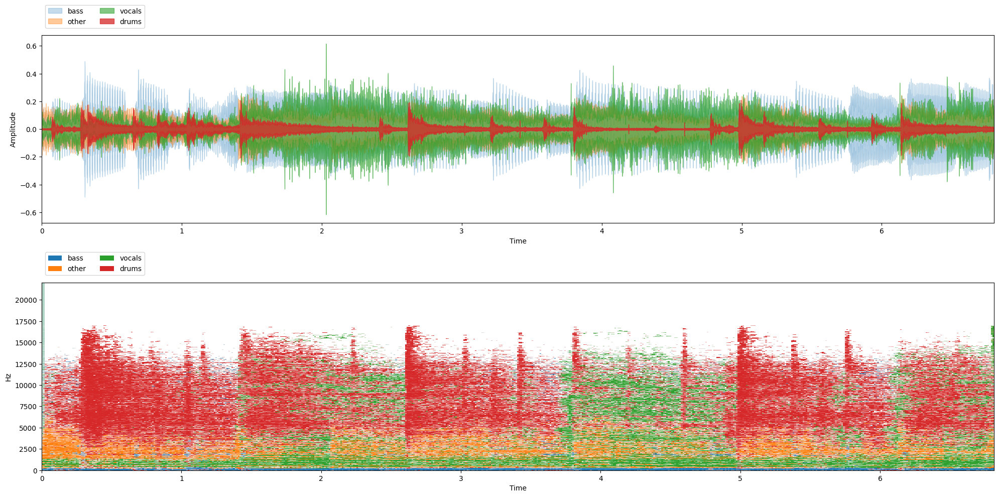


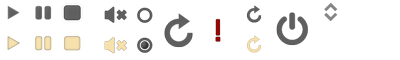
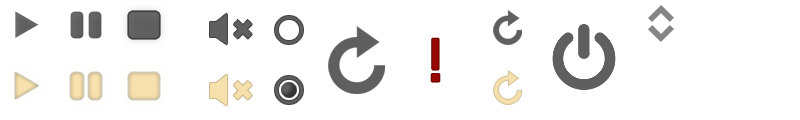
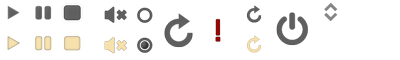

In [11]:
viz.show_sources(item['sources'])

In [15]:
from pathlib import Path

# create foreground folder
fg_folder = Path('~/.nussl/ismir2020-tutorial/foreground').expanduser()  
fg_folder.mkdir(parents=True, exist_ok=True)                             

# create background folder - we need to provide one even if we don't use it
bg_folder = Path('~/.nussl/ismir2020-tutorial/background').expanduser()
bg_folder.mkdir(parents=True, exist_ok=True)

In [18]:
# For each item (track) in the train set, iterate over its sources (stems),
# create a folder for the stem if it doesn't exist already (drums, bass, vocals, other) 
# and place the stem audio file in this folder, using the song name as the filename
for item in musdb_train:
    song_name = item['mix'].file_name
    for key, val in item['sources'].items():
        src_path = fg_folder / key 
        src_path.mkdir(exist_ok=True)
        src_path = str(src_path / song_name) + '.wav'
        val.write_audio_to_file(src_path)

In [19]:
import os
import glob

for folder in os.listdir(fg_folder):
    if folder[0] != '.':  # ignore system folders
        stem_files = os.listdir(os.path.join(fg_folder, folder))
        print(f"\n{folder}\tfolder contains {len(stem_files)} audio files:\n")
        for sf in sorted(stem_files)[:5]:
            print(f"\t\t{sf}")
        print("\t\t...")


drums	folder contains 94 audio files:

		A Classic Education - NightOwl.wav
		ANiMAL - Clinic A.wav
		ANiMAL - Easy Tiger.wav
		ANiMAL - Rockshow.wav
		Actions - Devil's Words.wav
		...

bass	folder contains 94 audio files:

		A Classic Education - NightOwl.wav
		ANiMAL - Clinic A.wav
		ANiMAL - Easy Tiger.wav
		ANiMAL - Rockshow.wav
		Actions - Devil's Words.wav
		...

other	folder contains 94 audio files:

		A Classic Education - NightOwl.wav
		ANiMAL - Clinic A.wav
		ANiMAL - Easy Tiger.wav
		ANiMAL - Rockshow.wav
		Actions - Devil's Words.wav
		...

vocals	folder contains 94 audio files:

		A Classic Education - NightOwl.wav
		ANiMAL - Clinic A.wav
		ANiMAL - Easy Tiger.wav
		ANiMAL - Rockshow.wav
		Actions - Devil's Words.wav
		...


In [21]:
import scaper

seed = 123 # integer or np.random.RandomState(<integer>)

sc = scaper.Scaper(
    duration=5.0,
    fg_path=str(fg_folder),
    bg_path=str(bg_folder),
    random_state=seed
)

In [22]:
sc.sr = 44100
sc.n_channels = 1
sc.ref_db = -20

In [23]:
labels = ['vocals', 'drums', 'bass', 'other']

for label in labels:
    sc.add_event(label=('const', label),                # set the label value explicitly using a constant
                 source_file=('choose', []),            # choose the source file randomly from all files in the folder
                 source_time=('uniform', 0, 7),         # sample the source (stem) audio starting at a time between 0-7
                 event_time=('const', 0),               # always add the stem at time 0 in the mixture
                 event_duration=('const', sc.duration), # set the stem duration to match the mixture duration
                 snr=('uniform', -5, 5),                # choose an SNR for the stem uniformly between -5 and 5 dB
                 pitch_shift=('uniform', -2, 2),        # apply a random pitch shift between -2 and 2 semitones
                 time_stretch=('uniform', 0.8, 1.2))    # apply a random time stretch between 0.8 (faster) and 1.2 (slower)

In [24]:
mixture_audio, mixture_jam, annotation_list, stem_audio_list = sc.generate()

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: drums source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: bass source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper

In [25]:
# extract the annotation data from the JAMS object
ann = mixture_jam.annotations.search(namespace='scaper')[0]

# print the sampled parameters for each event in the annotation
for event in ann:
    print(f"\n{event.value['label']}:\n")
    print(event.value)


vocals:

{'label': 'vocals', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/vocals/Port St Willow - Stay Even.wav', 'source_time': 0.9942668075895806, 'event_time': 0, 'event_duration': 5.0, 'snr': 2.1946896978556305, 'role': 'foreground', 'pitch_shift': -0.30757415950215616, 'time_stretch': 0.8907405814256812}

drums:

{'label': 'drums', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/drums/Traffic Experiment - Sirens.wav', 'source_time': 1.0454477739410935, 'event_time': 0, 'event_duration': 5.0, 'snr': -3.600492373696155, 'role': 'foreground', 'pitch_shift': -0.39592977335518587, 'time_stretch': 0.9643697490836076}

bass:

{'label': 'bass', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/bass/Dreamers Of The Ghetto - Heavy Love.wav', 'source_time': 0.10762590642068458, 'event_time': 0, 'event_duration': 5.0, 'snr': -1.0195574466956856, 'role': 'foreground', 'pitch_shift': 0.9519816229281428, 'time_str

In [26]:
# Launch this cell in a Jupyter notebook to generate an interactive vizualization of the annotation!
ann

<Annotation(namespace='scaper',
            time=0,
            duration=5.0,
            annotation_metadata=<AnnotationMetadata(...)>,
            data=<4 observations>,
            sandbox=<Sandbox(...)>)>

In [27]:
mixture_audio, mixture_jam, annotation_list, stem_audio_list = sc.generate(fix_clipping=True)

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: vocals event duration (5.00) with stretch factor 1.14 gives 5.70 which is greater than the soundscape duration (5.00), changing to 4.39 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (4.39), source time tuple changed to (uniform, 0, 2.416607193353477)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: drums source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: S

In [28]:
ann = mixture_jam.annotations.search(namespace='scaper')[0]

for event in ann:
    print(f"\n{event.value['label']}:\n")
    print(event.value)


vocals:

{'label': 'vocals', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/vocals/Night Panther - Fire.wav', 'source_time': 1.7507239493214413, 'event_time': 0, 'event_duration': 4.386839518664663, 'snr': 1.1102351067758285, 'role': 'foreground', 'pitch_shift': 0.8897735302808862, 'time_stretch': 1.1397727176311159}

drums:

{'label': 'drums', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/drums/Traffic Experiment - Once More (With Feeling).wav', 'source_time': 0.4116605732032902, 'event_time': 0, 'event_duration': 5.0, 'snr': -2.0628595361117066, 'role': 'foreground', 'pitch_shift': 0.523904495417951, 'time_stretch': 0.9447154622489257}

bass:

{'label': 'bass', 'source_file': '/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground/bass/Skelpolu - Human Mistakes.wav', 'source_time': 0.7770380338578964, 'event_time': 0, 'event_duration': 5.0, 'snr': -0.06314902349693785, 'role': 'foreground', 'pitch_shift': -0.29667883881668

In [29]:
# Launch this cell in a Jupyter notebook to generate an interactive vizualization of the annotation!
ann

<Annotation(namespace='scaper',
            time=0,
            duration=5.0,
            annotation_metadata=<AnnotationMetadata(...)>,
            data=<4 observations>,
            sandbox=<Sandbox(...)>)>

In [30]:
from IPython.display import Audio, display

display(Audio(data=mixture_audio.T, rate=sc.sr))

In [31]:
# extract the annotation data from the JAMS object
ann = mixture_jam.annotations.search(namespace='scaper')[0]

# iterate over the annotation and corresponding stem audio data
for obs, stem_audio in zip(ann.data, stem_audio_list):
    print(f"Instrument: {obs.value['label']} at SNR: {obs.value['snr']:.2f}")
    display(Audio(data=stem_audio.T, rate=sc.sr))

Instrument: vocals at SNR: 1.11


Instrument: drums at SNR: -2.06


Instrument: bass at SNR: -0.06


Instrument: other at SNR: 4.44


In [32]:
# 1. Define a random seed
random_state = 123

# 2. Create a Scaper object
sc = scaper.Scaper(
    duration=5.0,
    fg_path=str(fg_folder),
    bg_path=str(bg_folder),
    random_state=random_state
)

# 3. Set sample rate, reference dB, and channels (mono)
sc.sr = 44100
sc.ref_db = -20
sc.n_channels = 1

# 4. Define a template of probabilistic event parameters
event_parameters = {
    'label': ('const', 'vocals'),              
    'source_file': ('choose', []),             
    'source_time': ('uniform', 0, 7),
    'event_time': ('const', 0),
    'event_duration': ('const', sc.duration),
    'snr': ('uniform', -5, 5),
    'pitch_shift': ('uniform', -2, 2),
    'time_stretch': ('uniform', 0.8, 1.2)
}

# 5. Instatiate the template once to randomly choose a song,
#    a start time for the sources, a pitch shift and a time
#    stretch. These values must remain COHERENT across all stems
   
# Add a an event based on the probabilistic template
sc.add_event(**event_parameters)

# Instantiate the event to sample concrete values
event = sc._instantiate_event(sc.fg_spec[0])
    
# 6. Reset the Scaper object's event specficiation
sc.reset_fg_event_spec()
    
# 7. Replace the distributions for source time, pitch shift and
#    time stretch with the constant values we just sampled, to 
#    ensure our added events (stems) are coherent.    
#    NOTE: the source_file has also been sampled, and we'll keep
#    the sampled file to denote which song we'll be mixing.
event_parameters['source_time'] = ('const', event.source_time)
event_parameters['pitch_shift'] = ('const', event.pitch_shift)
event_parameters['time_stretch'] = ('const', event.time_stretch)

# 8. Iterate over the four stems (vocals, drums, bass, other) and 
#    add COHERENT events.
labels = ['vocals', 'drums', 'bass', 'other']

for label in labels:

    # Set the label to the stem we are adding
    event_parameters['label'] = ('const', label)

    # To ensure coherent source files (all from the same song), we leverage
    # the fact that all the stems from the same song have the same filename.
    # All we have to do is replace the stem file's parent folder name from "vocals" 
    # to the label we are adding in this iteration of the loop, which will give the 
    # correct path to the stem source file for this current label.
    coherent_source_file = event.source_file.replace('vocals', label)
    event_parameters['source_file'] = ('const', coherent_source_file)

    # Add the event using the modified, COHERENT, event parameters
    sc.add_event(**event_parameters)

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(


In [33]:
def generate_and_play(sc):

    mixture_audio, mixture_jam, annotation_list, stem_audio_list = sc.generate(fix_clipping=True)

    print("Mixture:")
    display(Audio(data=mixture_audio.T, rate=sc.sr))

    # extract the annotation data from the JAMS object
    ann = mixture_jam.annotations.search(namespace='scaper')[0]
    
    # iterate over the annotation and corresponding stem audio data
    for obs, stem_audio in zip(ann.data, stem_audio_list):
        print(f"Instrument: {obs.value['label']} at SNR: {obs.value['snr']:.2f}")
        display(Audio(data=stem_audio.T, rate=sc.sr))

In [34]:
generate_and_play(sc)

Mixture:


/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:2077: ScaperWarning: Soundscape audio is clipping!
  warnings.warn('Soundscape audio is clipping!',
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:2089: ScaperWarning: Peak normalization applied to fix clipping with scale factor = 0.598700502132977. The actual ref_db of the generated soundscape audio will change by approximately -4.46dB with respect to the target ref_db of -20)
  warnings.warn(


Instrument: vocals at SNR: 4.81


Instrument: drums at SNR: 1.85


Instrument: bass at SNR: -0.19


Instrument: other at SNR: -1.08


In [36]:
# Create a template of probabilistic event parameters
template_event_parameters = {
    'label': ('const', 'vocals'),
    'source_file': ('choose', []),
    'source_time': ('uniform', 0, 7),
    'event_time': ('const', 0),
    'event_duration': ('const', 5.0),
    'snr': ('uniform', -5, 5),
    'pitch_shift': ('uniform', -2, 2),
    'time_stretch': ('uniform', 0.8, 1.2)
}


def incoherent(fg_folder, bg_folder, event_template, seed):
    """
    This function takes the paths to the MUSDB18 source materials, an event template, 
    and a random seed, and returns an INCOHERENT mixture (audio + annotations). 
    
    Stems in INCOHERENT mixtures may come from different songs and are not temporally
    aligned.
    
    Parameters
    ----------
    fg_folder : str
        Path to the foreground source material for MUSDB18
    bg_folder : str
        Path to the background material for MUSDB18 (empty folder)
    event_template: dict
        Dictionary containing a template of probabilistic event parameters
    seed : int or np.random.RandomState()
        Seed for setting the Scaper object's random state. Different seeds will 
        generate different mixtures for the same source material and event template.
        
    Returns
    -------
    mixture_audio : np.ndarray
        Audio signal for the mixture
    mixture_jams : np.ndarray
        JAMS annotation for the mixture
    annotation_list : list
        Simple annotation in list format
    stem_audio_list : list
        List containing the audio signals of the stems that comprise the mixture
    """
    
    # Create scaper object and seed random state
    sc = scaper.Scaper(
        duration=5.0,
        fg_path=str(fg_folder),
        bg_path=str(bg_folder),
        random_state=seed
    )
    
    # Set sample rate, reference dB, and channels (mono)
    sc.sr = 44100
    sc.ref_db = -20
    sc.n_channels = 1
    
    # Copy the template so we can change it
    event_parameters = event_template.copy()
    
    # Iterate over stem types and add INCOHERENT events
    labels = ['vocals', 'drums', 'bass', 'other']
    for label in labels:
        event_parameters['label'] = ('const', label)
        sc.add_event(**event_parameters)
    
    # Return the generated mixture audio + annotations 
    # while ensuring we prevent audio clipping
    return sc.generate(fix_clipping=True)


def coherent(fg_folder, bg_folder, event_template, seed):
    """
    This function takes the paths to the MUSDB18 source materials and a random seed,
    and returns an COHERENT mixture (audio + annotations).
    
    Stems in COHERENT mixtures come from the same song and are temporally aligned.
    
    Parameters
    ----------
    fg_folder : str
        Path to the foreground source material for MUSDB18
    bg_folder : str
        Path to the background material for MUSDB18 (empty folder)
    event_template: dict
        Dictionary containing a template of probabilistic event parameters
    seed : int or np.random.RandomState()
        Seed for setting the Scaper object's random state. Different seeds will 
        generate different mixtures for the same source material and event template.
        
    Returns
    -------
    mixture_audio : np.ndarray
        Audio signal for the mixture
    mixture_jams : np.ndarray
        JAMS annotation for the mixture
    annotation_list : list
        Simple annotation in list format
    stem_audio_list : list
        List containing the audio signals of the stems that comprise the mixture
    """
        
    # Create scaper object and seed random state
    sc = scaper.Scaper(
        duration=5.0,
        fg_path=str(fg_folder),
        bg_path=str(bg_folder),
        random_state=seed
    )
    
    # Set sample rate, reference dB, and channels (mono)
    sc.sr = 44100
    sc.ref_db = -20
    sc.n_channels = 1
    
    # Copy the template so we can change it
    event_parameters = event_template.copy()    
    
    # Instatiate the template once to randomly choose a song,   
    # a start time for the sources, a pitch shift and a time    
    # stretch. These values must remain COHERENT across all stems
    sc.add_event(**event_parameters)
    event = sc._instantiate_event(sc.fg_spec[0])
    
    # Reset the Scaper object's the event specification
    sc.reset_fg_event_spec()
    
    # Replace the distributions for source time, pitch shift and 
    # time stretch with the constant values we just sampled, to  
    # ensure our added events (stems) are coherent.              
    event_parameters['source_time'] = ('const', event.source_time)
    event_parameters['pitch_shift'] = ('const', event.pitch_shift)
    event_parameters['time_stretch'] = ('const', event.time_stretch)

    # Iterate over the four stems (vocals, drums, bass, other) and 
    # add COHERENT events.                                         
    labels = ['vocals', 'drums', 'bass', 'other']
    for label in labels:
        
        # Set the label to the stem we are adding
        event_parameters['label'] = ('const', label)
        
        # To ensure coherent source files (all from the same song), we leverage
        # the fact that all the stems from the same song have the same filename.
        # All we have to do is replace the stem file's parent folder name from "vocals" 
        # to the label we are adding in this iteration of the loop, which will give the 
        # correct path to the stem source file for this current label.
        coherent_source_file = event.source_file.replace('vocals', label)
        event_parameters['source_file'] = ('const', coherent_source_file)
        # Add the event using the modified, COHERENT, event parameters
        sc.add_event(**event_parameters)
    
    # Generate and return the mixture audio, stem audio, and annotations
    return sc.generate(fix_clipping=True)

In [37]:
# First double check our paths and template are correct:
print(fg_folder)
print(bg_folder)
print("")
print(template_event_parameters)

/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/foreground
/SFS/user/ry/stonekev/.nussl/ismir2020-tutorial/background

{'label': ('const', 'vocals'), 'source_file': ('choose', []), 'source_time': ('uniform', 0, 7), 'event_time': ('const', 0), 'event_duration': ('const', 5.0), 'snr': ('uniform', -5, 5), 'pitch_shift': ('uniform', -2, 2), 'time_stretch': ('uniform', 0.8, 1.2)}


In [38]:
# Generate 3 coherent mixtures
for seed in [1, 2, 3]:
    
    mixture_audio, mixture_jam, annotation_list, stem_audio_list = coherent(
        fg_folder, 
        bg_folder, 
        template_event_parameters, 
        seed)
    
    display(Audio(data=mixture_audio.T, rate=sc.sr))

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: vocals event duration (5.00) with stretch factor 1.20 gives 5.99 which is greater than the soundscape duration (5.00), changing to 4.17 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (4.17), source time tuple changed to (uniform, 0, 2.632866387982543)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: drums event duration (5.00) with stretch factor 1.20 gives 5.99 which is greater than the soundscape duration (5.00), changing to 4.17 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: bas

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:2077: ScaperWarning: Soundscape audio is clipping!
  warnings.warn('Soundscape audio is clipping!',
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:2089: ScaperWarning: Peak normalization applied to fix clipping with scale factor = 0.5375095009623521. The actual ref_db of the generated soundscape audio will change by approximately -5.39dB with respect to the target ref_db of -20)
  warnings.warn(


/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: vocals event duration (5.00) with stretch factor 1.08 gives 5.42 which is greater than the soundscape duration (5.00), changing to 4.62 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (4.62), source time tuple changed to (uniform, 0, 2.187745938374399)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: drums event duration (5.00) with stretch factor 1.08 gives 5.42 which is greater than the soundscape duration (5.00), changing to 4.62 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: bas

In [39]:
# Generate 3 incoherent mixtures
for seed in [1, 2, 3]:
    
    mixture_audio, mixture_jam, annotation_list, stem_audio_list = incoherent(
        fg_folder, 
        bg_folder, 
        template_event_parameters, 
        seed)
    
    display(Audio(data=mixture_audio.T, rate=sc.sr))

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: vocals event duration (5.00) with stretch factor 1.20 gives 5.99 which is greater than the soundscape duration (5.00), changing to 4.17 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (4.17), source time tuple changed to (uniform, 0, 2.632866387982543)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: drums source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: S

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: drums source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: bass event duration (5.00) with stretch factor 1.05 gives 5.27 which is greater than the soundscape duration (5.00), changing to 4.75 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: Sc

/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1540: ScaperWarning: vocals event duration (5.00) with stretch factor 1.08 gives 5.42 which is greater than the soundscape duration (5.00), changing to 4.62 (5.00 after time stretching)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: vocals source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (4.62), source time tuple changed to (uniform, 0, 2.187745938374399)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: ScaperWarning: drums source time tuple (uniform, 0, 7) could not be satisfied given source duration (6.80) and event duration (5.00), source time tuple changed to (uniform, 0, 1.8034467120181406)
  warnings.warn(
/SFS/user/ry/stonekev/miniconda3/envs/audio/lib/python3.10/site-packages/scaper/core.py:1575: S

In [40]:
import numpy as np

def generate_mixture(dataset, fg_folder, bg_folder, event_template, seed):
    
    # hide warnings
    with warnings.catch_warnings():
        warnings.filterwarnings('ignore')
        
        # flip a coint to choose coherent or incoherent mixing
        random_state = np.random.RandomState(seed)
        
        # generate mixture
        if random_state.rand() > .5:
            data = coherent(fg_folder, bg_folder, event_template, seed)
        else:
            data = incoherent(fg_folder, bg_folder, event_template, seed)
            
    # unpack the data
    mixture_audio, mixture_jam, annotation_list, stem_audio_list = data
    
    # convert mixture to nussl format
    mix = dataset._load_audio_from_array(
        audio_data=mixture_audio, sample_rate=dataset.sample_rate
    )
    
    # convert stems to nussl format
    sources = {}
    ann = mixture_jam.annotations.search(namespace='scaper')[0]
    for obs, stem_audio in zip(ann.data, stem_audio_list):
        key = obs.value['label']
        sources[key] = dataset._load_audio_from_array(
            audio_data=stem_audio, sample_rate=dataset.sample_rate
        )
    
    # store the mixture, stems and JAMS annotation in the format expected by nussl
    output = {
        'mix': mix,
        'sources': sources,
        'metadata': mixture_jam
    }
    return output

In [43]:
# Convenience class so we don't need to enter the fg_folder, bg_folder, and template each time
class MixClosure:
    
    def __init__(self, fg_folder, bg_folder, event_template):
        self.fg_folder = fg_folder
        self.bg_folder = bg_folder
        self.event_template = event_template
        
    def __call__(self, dataset, seed):
        return generate_mixture(dataset, self.fg_folder, self.bg_folder, self.event_template, seed)
    
# Initialize our mixing function with our specific source material and event template
mix_func = MixClosure(fg_folder, bg_folder, template_event_parameters)

# Create a nussle OnTheFly data generator
on_the_fly = nussl.datasets.OnTheFly(
    num_mixtures=1000,
    mix_closure=mix_func
)

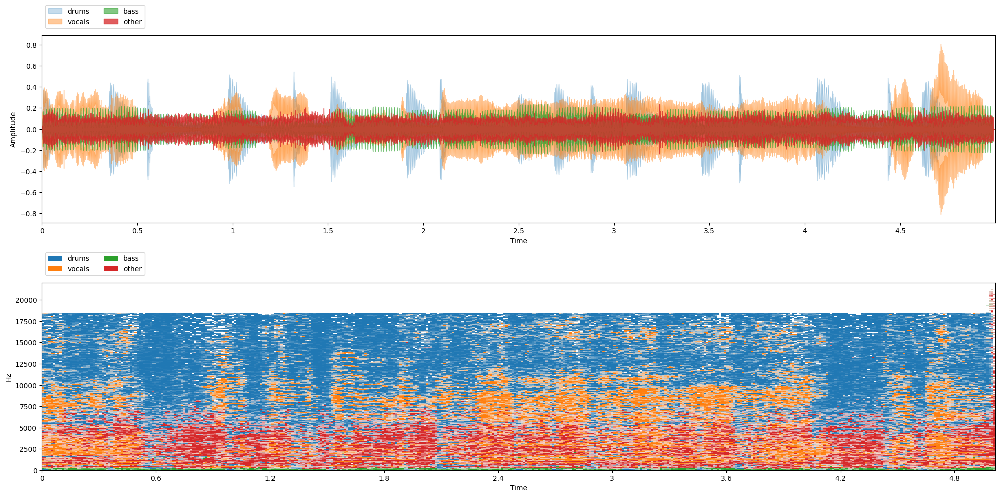


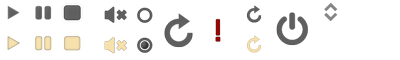
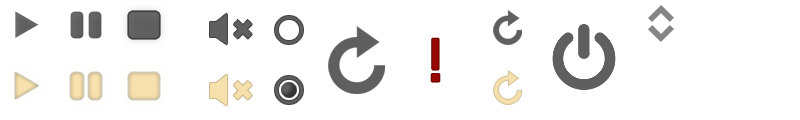
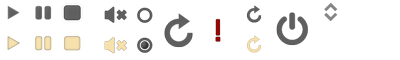

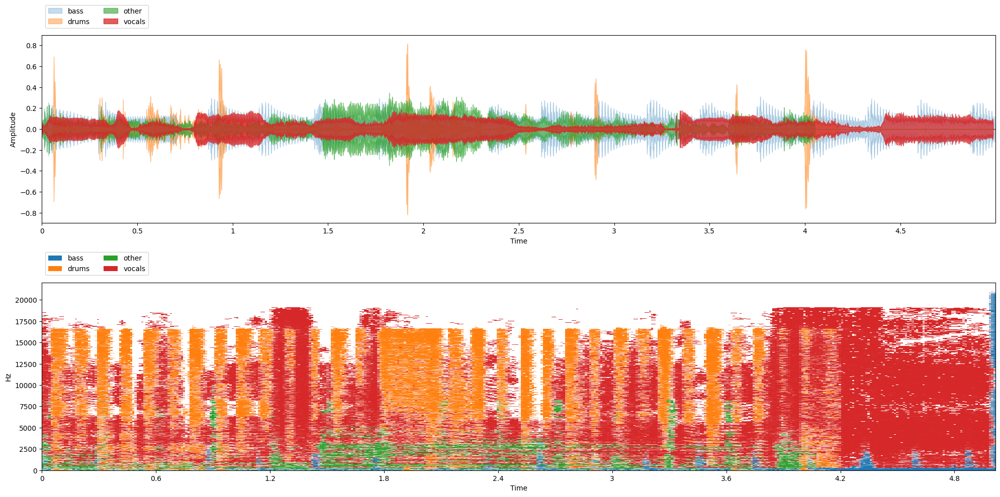


...
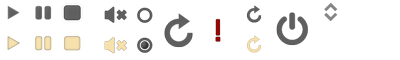

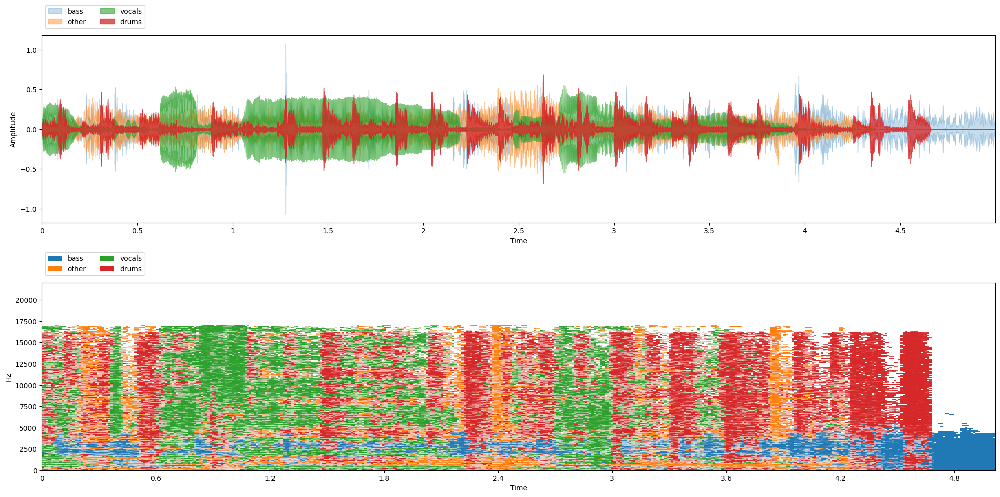


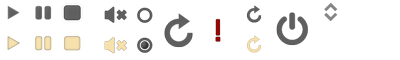
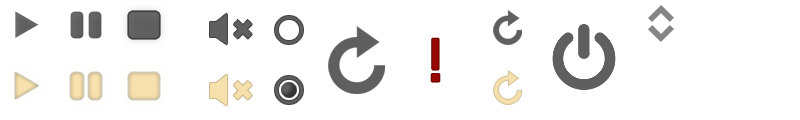
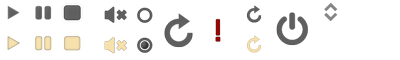

In [45]:
from utils import viz

for i in range(3):
    item = on_the_fly[i]
    mix = item['mix']
    sources = item['sources']

    viz.show_sources(sources)